In [ ]:
# Action Recognition from Videos using CNN + LSTM
# By - Manav Malik

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Download UCF101 Dataset to Google Drive
# !wget --no-check-certificate -O /content/drive/MyDrive/UCF101.rar "https://www.crcv.ucf.edu/data/UCF101/UCF101.rar"

In [ ]:
# Extract UCF101 .rar File
# !sudo apt-get install -y unrar
# !unrar x /content/drive/MyDrive/UCF101.rar /content/drive/MyDrive/UCF-101/

In [ ]:
# # Step A: download the recognition split ZIP
# !wget --no-check-certificate \
#     -O /content/drive/MyDrive/UCF101TrainTestSplits-RecognitionTask.zip \
#     "https://www.crcv.ucf.edu/data/UCF101/UCF101TrainTestSplits-RecognitionTask.zip"

# # Step B: unzip it into your Drive
# !unzip -q /content/drive/MyDrive/UCF101TrainTestSplits-RecognitionTask.zip \
#        -d /content/drive/MyDrive/


In [ ]:
# Extract Frames from Videos
# import os
# import cv2
# from tqdm import tqdm

UCF_ROOT    = '/content/drive/MyDrive/UCF-101/UCF-101'
FRAME_OUTPUT= '/content/drive/MyDrive/UCF101_frames'
# os.makedirs(FRAME_OUTPUT, exist_ok=True)

# def extract_frames(video_path, output_folder, max_frames=50):
#     cap   = cv2.VideoCapture(video_path)
#     total = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
#     if total == 0:
#         cap.release(); return
#     frames_to_save = min(max_frames, total)
#     step = max(1, total // frames_to_save)
#     count = saved = 0
#     while cap.isOpened() and saved < frames_to_save:
#         ret, frame = cap.read()
#         if not ret: break
#         if count % step == 0:
#             p = os.path.join(output_folder, f'frame_{saved:03d}.jpg')
#             cv2.imwrite(p, frame); saved += 1
#         count += 1
#     cap.release()

# actions = sorted(os.listdir(UCF_ROOT))[:5]  # your 5 classes
# for action in tqdm(actions, desc="Processing Classes"):
#     vids = sorted(os.listdir(os.path.join(UCF_ROOT, action)))[:20]
#     for vid in vids:
#         src = os.path.join(UCF_ROOT, action, vid)
#         dst = os.path.join(FRAME_OUTPUT, action, vid.split('.')[0])
#         os.makedirs(dst, exist_ok=True)
#         extract_frames(src, dst)

In [ ]:
# import os, glob, random

# # Paths
FRAME_OUTPUT = '/content/drive/MyDrive/UCF101_frames'
OUT_DIR      = '/content/drive/MyDrive'

# # 1) Collect all (action, video_folder, label) tuples
# actions = sorted(os.listdir(FRAME_OUTPUT))
# entries = []
# for label, action in enumerate(actions):
#     action_dir = os.path.join(FRAME_OUTPUT, action)
#     for vid_folder in sorted(os.listdir(action_dir)):
#         # e.g. ('ApplyEyeMakeup', 'V_ApplyEyeMakeup_g01_c01', 0)
#         entries.append((action, vid_folder, label))

# # 2) Shuffle and split 80/20
# random.seed(42)
# random.shuffle(entries)
# split_idx = int(0.8 * len(entries))
# train_entries = entries[:split_idx]
# test_entries  = entries[split_idx:]

# # 3) Write train_small.txt
# with open(os.path.join(OUT_DIR, 'train_small.txt'), 'w') as f:
#     for action, vid, label in train_entries:
#         # UCF101 labels are 1-based
#         f.write(f"{action}/{vid}.avi {label+1}\n")

# # 4) Write test_small.txt
# with open(os.path.join(OUT_DIR, 'test_small.txt'), 'w') as f:
#     for action, vid, label in test_entries:
#         f.write(f"{action}/{vid}.avi {label+1}\n")

# print(f"✔️ Wrote {len(train_entries)} training and {len(test_entries)} testing entries.")


Found 50 frames in /content/drive/MyDrive/UCF101_frames/ApplyEyeMakeup/v_ApplyEyeMakeup_g01_c01


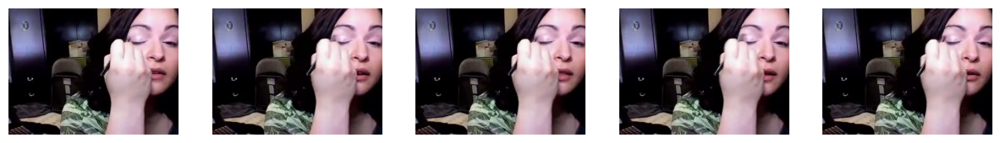

In [ ]:
import matplotlib.pyplot as plt
import glob
import cv2
import os

# Replace this with your actual folder:
sample_folder = "/content/drive/MyDrive/UCF101_frames/ApplyEyeMakeup/v_ApplyEyeMakeup_g01_c01"

# Grab all .jpg files in that folder
frames = sorted(glob.glob(os.path.join(sample_folder, "*.jpg")))
print(f"Found {len(frames)} frames in {sample_folder}")

# Plot the first 5 frames
plt.figure(figsize=(15,3))
for i, frame_path in enumerate(frames[:5]):
    img = cv2.imread(frame_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.subplot(1,5,i+1)
    plt.imshow(img)
    plt.axis('off')
plt.show()


In [ ]:
# === Imports & Dataset Definition ===
import os
import random
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image

class VideoFrameDataset(Dataset):
    def __init__(self, root_dir, split_file, transform=None, seq_length=50):
        self.root_dir    = root_dir
        self.transform   = transform
        self.seq_length  = seq_length
        self.samples     = []
        with open(split_file, 'r') as f:
            for line in f:
                path, label = line.strip().split()
                action, vid = path.split('/', 1)
                folder = os.path.join(root_dir, action, vid.replace('.avi',''))
                if os.path.isdir(folder):
                    self.samples.append((folder, int(label)-1))

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        folder, label = self.samples[idx]
        frames = sorted(os.listdir(folder))[:self.seq_length]
        seq = []
        for fname in frames:
            img = Image.open(os.path.join(folder, fname)).convert('RGB')
            if self.transform:
                img = self.transform(img)
            seq.append(img)
        return torch.stack(seq), label

# === Frame Transforms ===
frame_transform = transforms.Compose([
    transforms.Resize((224,224)),
    transforms.ToTensor(),
    transforms.Normalize([0.485,0.456,0.406],
                         [0.229,0.224,0.225]),
])


In [ ]:
train_ds = VideoFrameDataset(
    root_dir='/content/drive/MyDrive/UCF101_frames',
    split_file='/content/drive/MyDrive/train_small.txt',
    transform=frame_transform,
    seq_length=50
)
test_ds = VideoFrameDataset(
    root_dir='/content/drive/MyDrive/UCF101_frames',
    split_file='/content/drive/MyDrive/test_small.txt',
    transform=frame_transform,
    seq_length=50
)
print(f"Train samples: {len(train_ds)}, Test samples: {len(test_ds)}")

Train samples: 80, Test samples: 20


In [ ]:
!du -sh /content/drive/MyDrive/UCF101_frames

103M	/content/drive/MyDrive/UCF101_frames


In [ ]:
# !rm -rf /content/UCF101_frames
!ls /content

drive  __MACOSX  sample_data  UCF101_frames  UCF101_frames.zip


In [ ]:
# 1) Move it locally
!mv /content/drive/MyDrive/UCF101_frames.zip /content/

# 2) Unzip into /content
!unzip -q /content/UCF101_frames.zip -d /content/

In [ ]:
import os
import torch
from torch.utils.data import DataLoader
from torchvision import transforms
from PIL import Image

# 1) Check device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print("Device:", device)

# 2) Paths
FRAME_DIR   =  '/content/UCF101_frames'
TRAIN_SPLIT = '/content/drive/MyDrive/train_small.txt'
TEST_SPLIT  = '/content/drive/MyDrive/test_small.txt'
print("Frame dir exists:", os.path.isdir(FRAME_DIR))
print("Train split exists:", os.path.isfile(TRAIN_SPLIT))
print("Test split exists:", os.path.isfile(TEST_SPLIT))

# 3) Quick Dataset + Loader test
class QuickDS(torch.utils.data.Dataset):
    def __init__(self, root, split, transform, seq_len=5):
        self.transform = transform
        self.samples = []
        with open(split) as f:
            for ln in f:
                cls, vid_lbl = ln.strip().split()
                cls, vid = cls.split('/',1)
                folder = os.path.join(root, cls, vid.replace('.avi',''))
                if os.path.isdir(folder):
                    self.samples.append(folder)
    def __len__(self):
        return len(self.samples)
    def __getitem__(self, i):
        folder = self.samples[i]
        imgs = sorted(os.listdir(folder))[:5]  # take 5 frames
        seq = []
        for fn in imgs:
            img = Image.open(os.path.join(folder, fn)).convert('RGB')
            if self.transform: img = self.transform(img)
            seq.append(img)
        return torch.stack(seq)

tf = transforms.Compose([
    transforms.Resize((224,224)),
    transforms.ToTensor()
])

ds = QuickDS(FRAME_DIR, TRAIN_SPLIT, tf)
loader = DataLoader(ds, batch_size=2, num_workers=0)

print(f"Train samples: {len(ds)}")
batch = next(iter(loader))
print("Batch shape:", batch.shape, "(should be [2, 5, 3, 224, 224])")


Device: cuda
Frame dir exists: True
Train split exists: True
Test split exists: True
Train samples: 80
Batch shape: torch.Size([2, 5, 3, 224, 224]) (should be [2, 5, 3, 224, 224])


Train samples: 80, Test samples: 20
Video‐level overlap (should be empty): set()

=== Epoch 1/10 ===
[Train] Batch 0, labels: [1, 0, 3, 1]


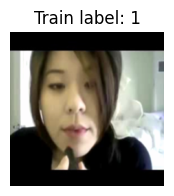

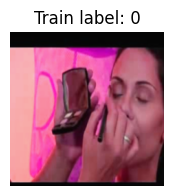

[Train] Batch 1, labels: [3, 2, 0, 4]


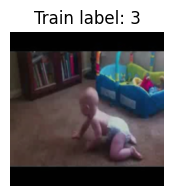

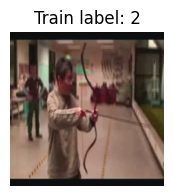

[Train] Batch 2, labels: [2, 2, 2, 3]


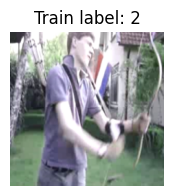

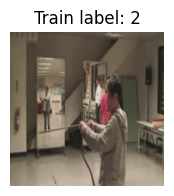

[Train] Batch 3, labels: [2, 2, 4, 3]


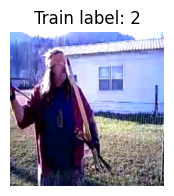

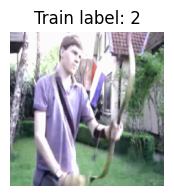

[Train] Batch 4, labels: [0, 2, 2, 1]


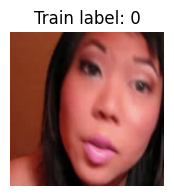

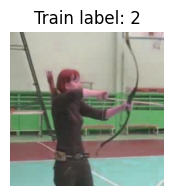

[Train] Batch 5, labels: [2, 1, 2, 1]


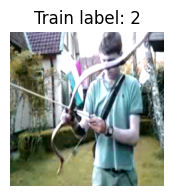

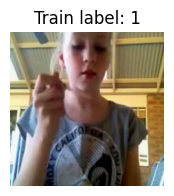

[Train] Batch 6, labels: [0, 0, 0, 4]


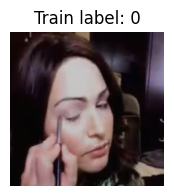

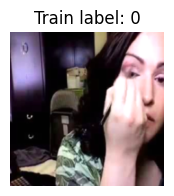

[Train] Batch 7, labels: [3, 2, 2, 3]


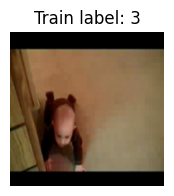

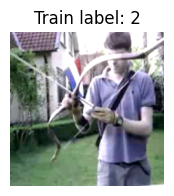

[Train] Batch 8, labels: [4, 1, 2, 1]


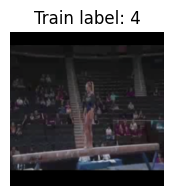

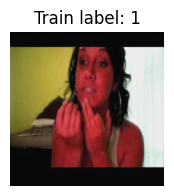

[Train] Batch 9, labels: [1, 3, 1, 0]


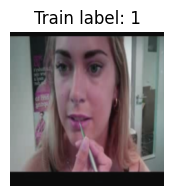

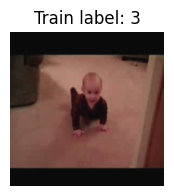

[Train] Batch 10, labels: [4, 4, 4, 1]


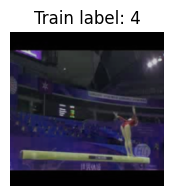

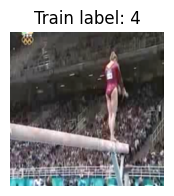

[Train] Batch 11, labels: [2, 4, 3, 0]


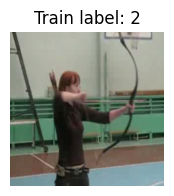

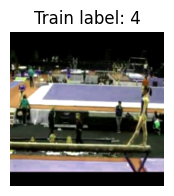

[Train] Batch 12, labels: [0, 3, 4, 0]


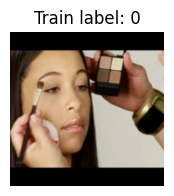

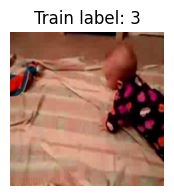

[Train] Batch 13, labels: [3, 1, 3, 0]


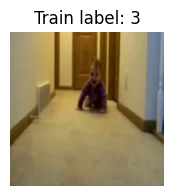

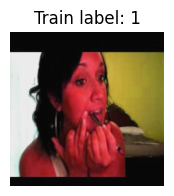

[Train] Batch 14, labels: [3, 2, 3, 3]


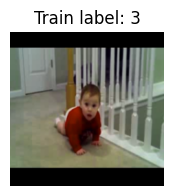

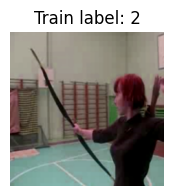

[Train] Batch 15, labels: [0, 3, 3, 4]


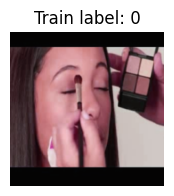

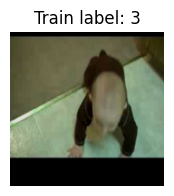

[Train] Batch 16, labels: [4, 1, 4, 4]


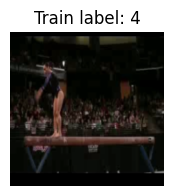

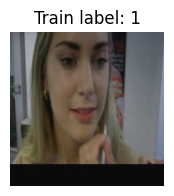

[Train] Batch 17, labels: [4, 2, 1, 2]


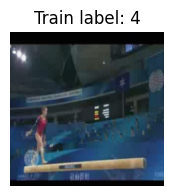

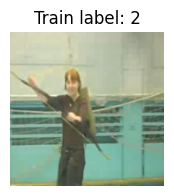

[Train] Batch 18, labels: [0, 4, 1, 1]


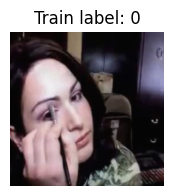

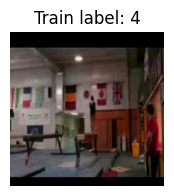

[Train] Batch 19, labels: [2, 3, 0, 2]


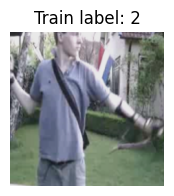

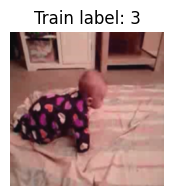

Train Loss: 1.4423, Acc: 0.500
[Val]   Batch 0, labels: [3, 1, 1, 4]


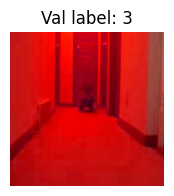

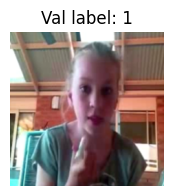

[Val]   Batch 1, labels: [4, 0, 2, 3]


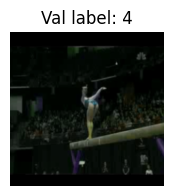

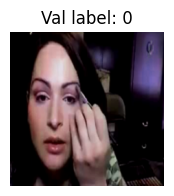

[Val]   Batch 2, labels: [0, 3, 4, 0]


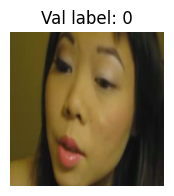

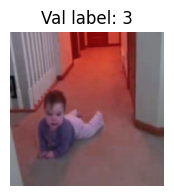

[Val]   Batch 3, labels: [0, 1, 1, 1]


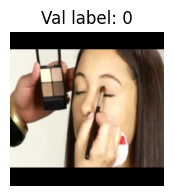

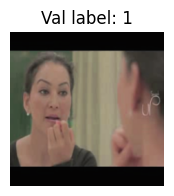

[Val]   Batch 4, labels: [4, 0, 0, 4]


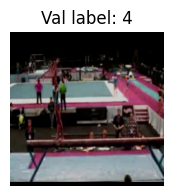

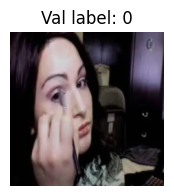

Val Loss:   1.0122, Acc: 0.800

=== Epoch 2/10 ===
[Train] Batch 0, labels: [2, 0, 4, 0]


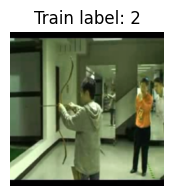

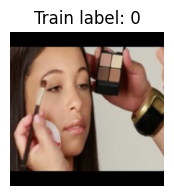

[Train] Batch 1, labels: [1, 4, 0, 3]


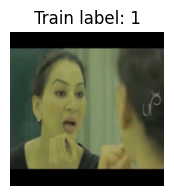

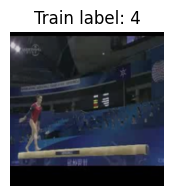

[Train] Batch 2, labels: [2, 2, 1, 3]


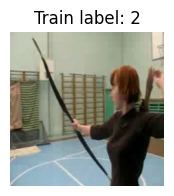

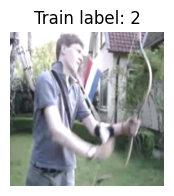

[Train] Batch 3, labels: [1, 1, 3, 3]


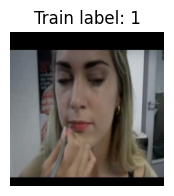

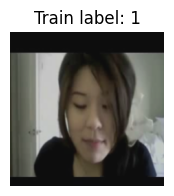

[Train] Batch 4, labels: [2, 0, 4, 4]


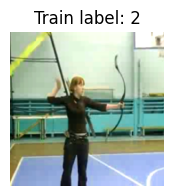

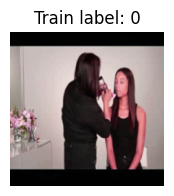

[Train] Batch 5, labels: [1, 0, 0, 2]


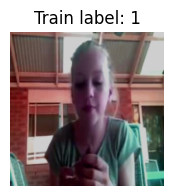

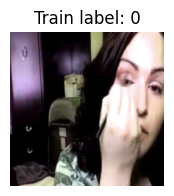

[Train] Batch 6, labels: [2, 0, 1, 1]


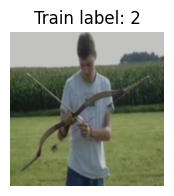

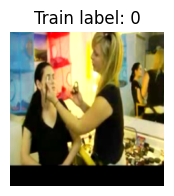

[Train] Batch 7, labels: [1, 4, 2, 0]


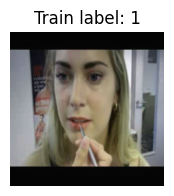

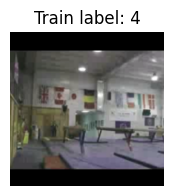

[Train] Batch 8, labels: [3, 1, 4, 1]


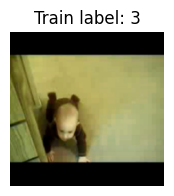

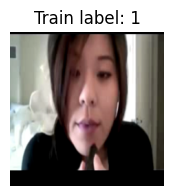

[Train] Batch 9, labels: [4, 3, 4, 0]


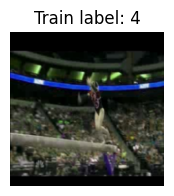

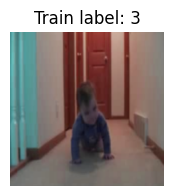

[Train] Batch 10, labels: [2, 2, 3, 2]


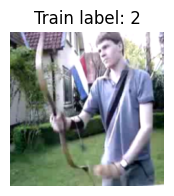

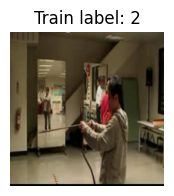

[Train] Batch 11, labels: [1, 3, 4, 1]


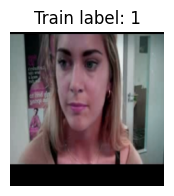

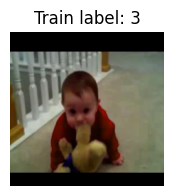

[Train] Batch 12, labels: [4, 3, 3, 3]


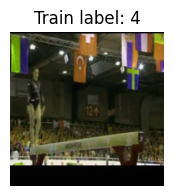

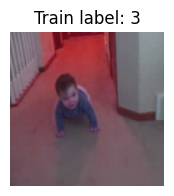

[Train] Batch 13, labels: [2, 0, 4, 2]


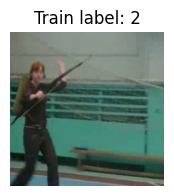

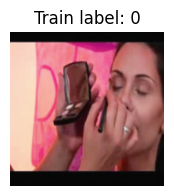

[Train] Batch 14, labels: [0, 3, 3, 2]


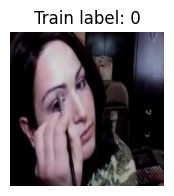

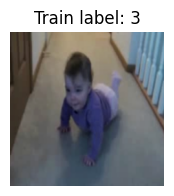

[Train] Batch 15, labels: [2, 1, 0, 2]


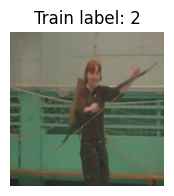

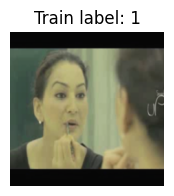

[Train] Batch 16, labels: [2, 0, 2, 3]


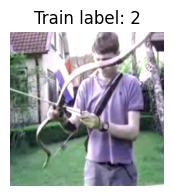

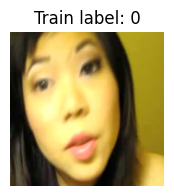

[Train] Batch 17, labels: [4, 3, 3, 1]


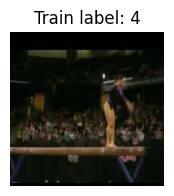

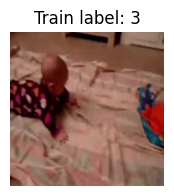

[Train] Batch 18, labels: [4, 2, 4, 2]


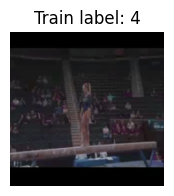

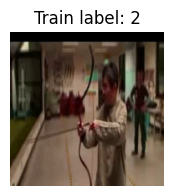

[Train] Batch 19, labels: [0, 4, 3, 1]


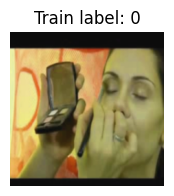

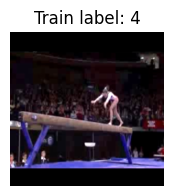

Train Loss: 0.7565, Acc: 0.975
[Val]   Batch 0, labels: [3, 1, 1, 4]


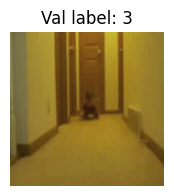

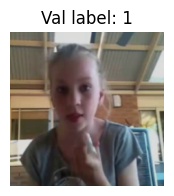

[Val]   Batch 1, labels: [4, 0, 2, 3]


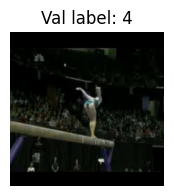

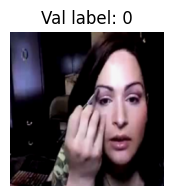

[Val]   Batch 2, labels: [0, 3, 4, 0]


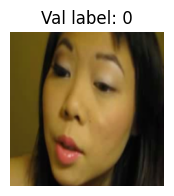

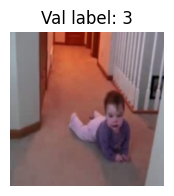

[Val]   Batch 3, labels: [0, 1, 1, 1]


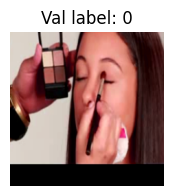

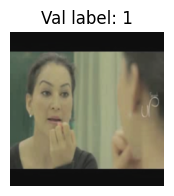

[Val]   Batch 4, labels: [4, 0, 0, 4]


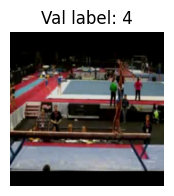

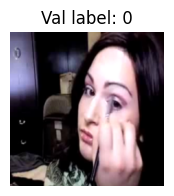

Val Loss:   0.3735, Acc: 1.000

=== Epoch 3/10 ===
[Train] Batch 0, labels: [4, 4, 4, 3]


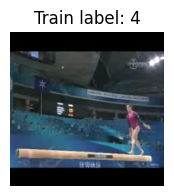

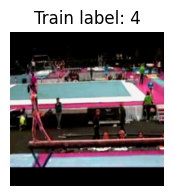

[Train] Batch 1, labels: [1, 3, 1, 0]


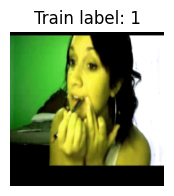

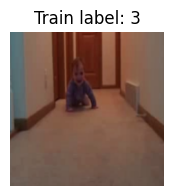

[Train] Batch 2, labels: [3, 1, 3, 2]


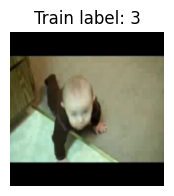

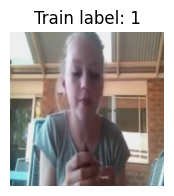

[Train] Batch 3, labels: [2, 0, 2, 3]


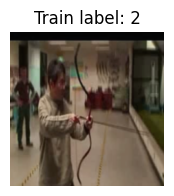

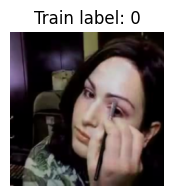

[Train] Batch 4, labels: [4, 3, 0, 0]


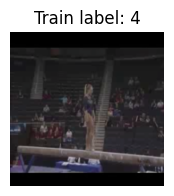

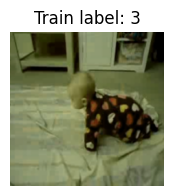

[Train] Batch 5, labels: [2, 2, 2, 4]


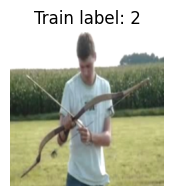

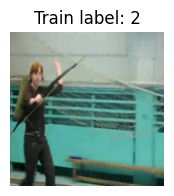

[Train] Batch 6, labels: [0, 3, 3, 3]


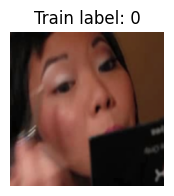

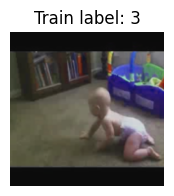

[Train] Batch 7, labels: [2, 4, 4, 2]


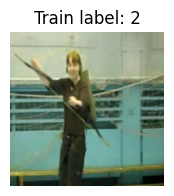

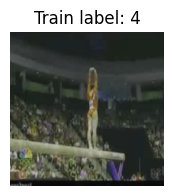

[Train] Batch 8, labels: [2, 1, 2, 0]


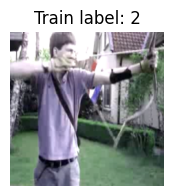

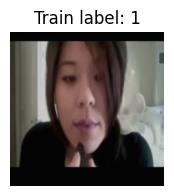

[Train] Batch 9, labels: [4, 3, 1, 2]


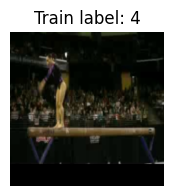

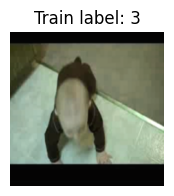

[Train] Batch 10, labels: [0, 4, 2, 2]


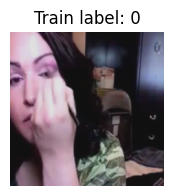

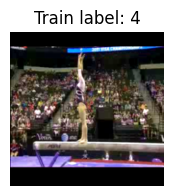

[Train] Batch 11, labels: [3, 2, 0, 1]


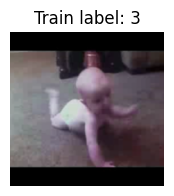

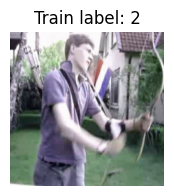

[Train] Batch 12, labels: [4, 1, 2, 2]


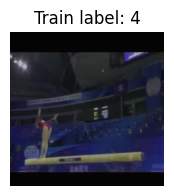

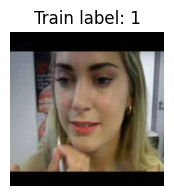

[Train] Batch 13, labels: [3, 1, 1, 3]


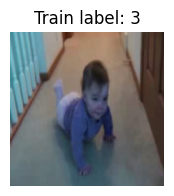

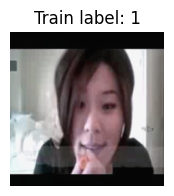

[Train] Batch 14, labels: [1, 3, 0, 4]


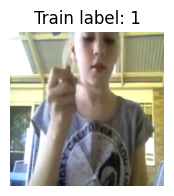

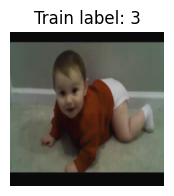

[Train] Batch 15, labels: [0, 4, 1, 3]


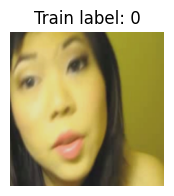

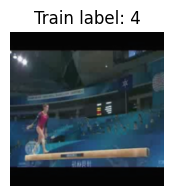

[Train] Batch 16, labels: [2, 1, 1, 3]


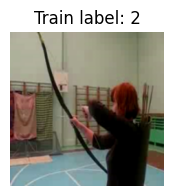

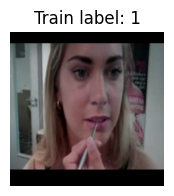

[Train] Batch 17, labels: [4, 0, 4, 0]


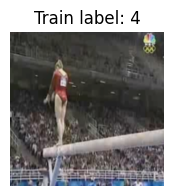

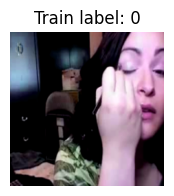

[Train] Batch 18, labels: [2, 2, 0, 3]


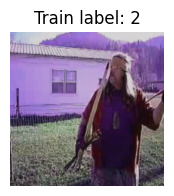

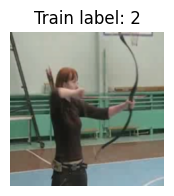

[Train] Batch 19, labels: [4, 1, 1, 0]


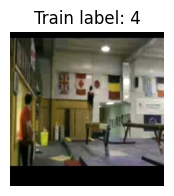

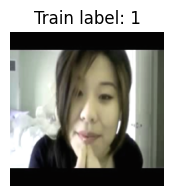

Train Loss: 0.3573, Acc: 0.975
[Val]   Batch 0, labels: [3, 1, 1, 4]


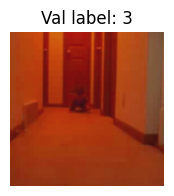

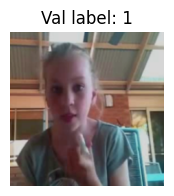

[Val]   Batch 1, labels: [4, 0, 2, 3]


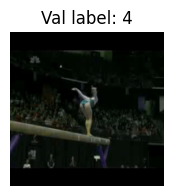

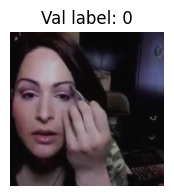

[Val]   Batch 2, labels: [0, 3, 4, 0]


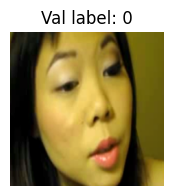

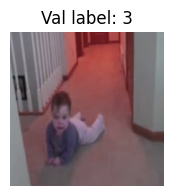

[Val]   Batch 3, labels: [0, 1, 1, 1]


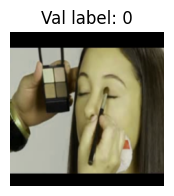

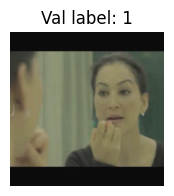

[Val]   Batch 4, labels: [4, 0, 0, 4]


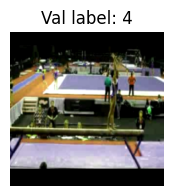

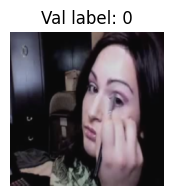

Val Loss:   0.1573, Acc: 1.000

=== Epoch 4/10 ===
[Train] Batch 0, labels: [4, 4, 2, 1]


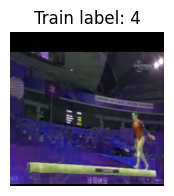

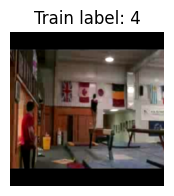

[Train] Batch 1, labels: [0, 2, 3, 0]


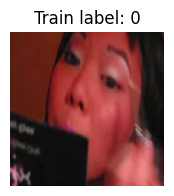

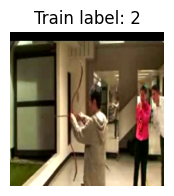

[Train] Batch 2, labels: [1, 4, 4, 2]


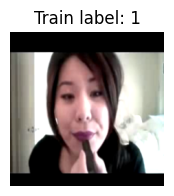

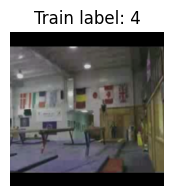

[Train] Batch 3, labels: [1, 3, 2, 2]


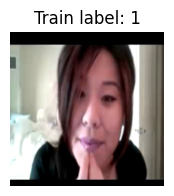

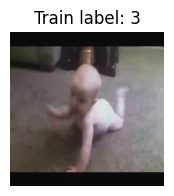

[Train] Batch 4, labels: [0, 3, 3, 3]


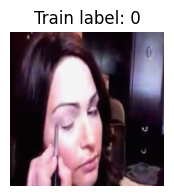

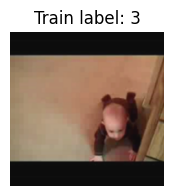

[Train] Batch 5, labels: [4, 3, 0, 3]


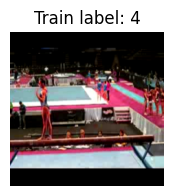

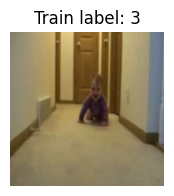

[Train] Batch 6, labels: [2, 1, 4, 2]


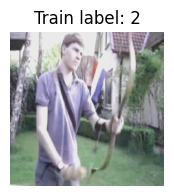

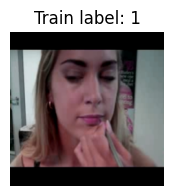

[Train] Batch 7, labels: [0, 0, 2, 4]


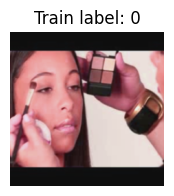

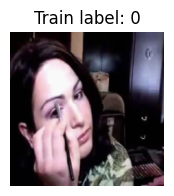

[Train] Batch 8, labels: [2, 4, 1, 2]


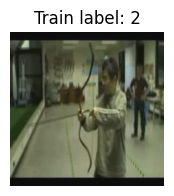

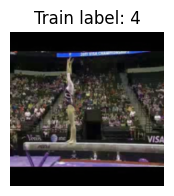

[Train] Batch 9, labels: [0, 0, 3, 1]


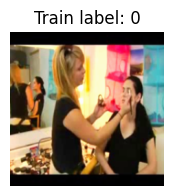

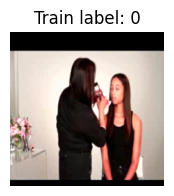

[Train] Batch 10, labels: [3, 2, 4, 1]


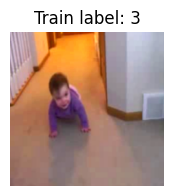

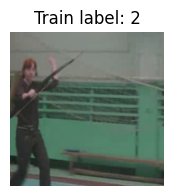

[Train] Batch 11, labels: [3, 0, 1, 0]


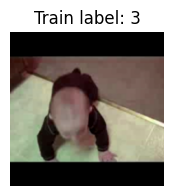

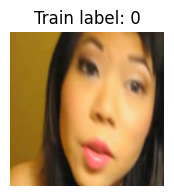

[Train] Batch 12, labels: [1, 2, 4, 3]


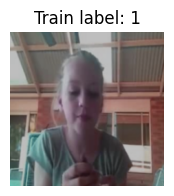

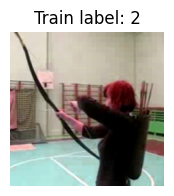

[Train] Batch 13, labels: [2, 1, 3, 0]


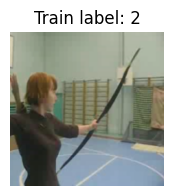

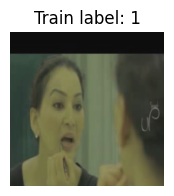

[Train] Batch 14, labels: [1, 3, 4, 4]


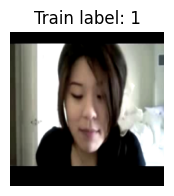

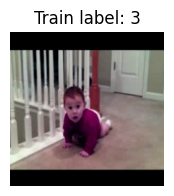

[Train] Batch 15, labels: [0, 4, 2, 1]


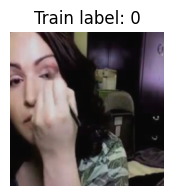

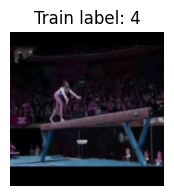

[Train] Batch 16, labels: [3, 2, 0, 2]


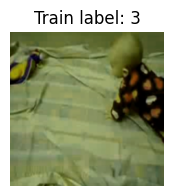

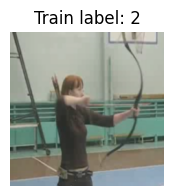

[Train] Batch 17, labels: [2, 1, 2, 4]


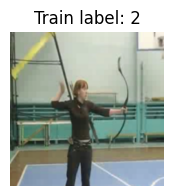

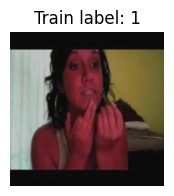

[Train] Batch 18, labels: [2, 3, 3, 1]


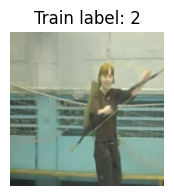

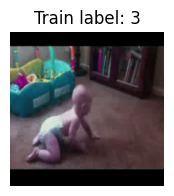

[Train] Batch 19, labels: [3, 0, 4, 1]


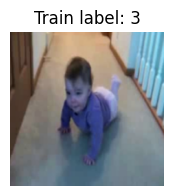

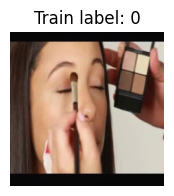

Train Loss: 0.1251, Acc: 1.000
[Val]   Batch 0, labels: [3, 1, 1, 4]


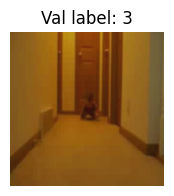

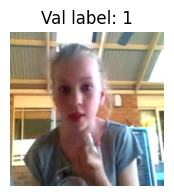

[Val]   Batch 1, labels: [4, 0, 2, 3]


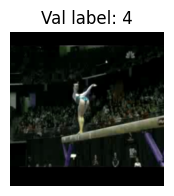

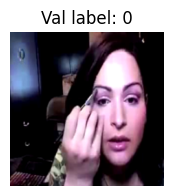

[Val]   Batch 2, labels: [0, 3, 4, 0]


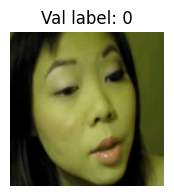

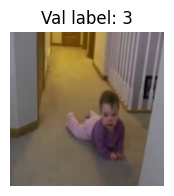

[Val]   Batch 3, labels: [0, 1, 1, 1]


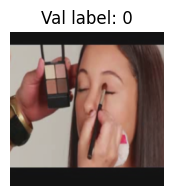

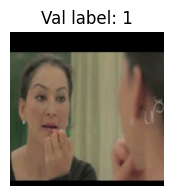

[Val]   Batch 4, labels: [4, 0, 0, 4]


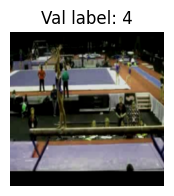

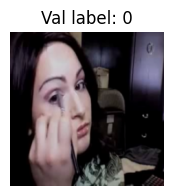

Val Loss:   0.0639, Acc: 1.000

=== Epoch 5/10 ===
[Train] Batch 0, labels: [3, 0, 2, 4]


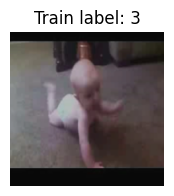

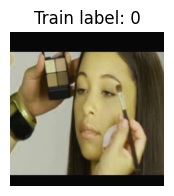

[Train] Batch 1, labels: [1, 1, 3, 3]


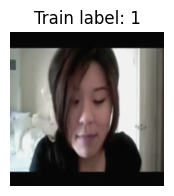

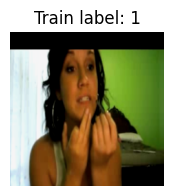

[Train] Batch 2, labels: [2, 0, 3, 0]


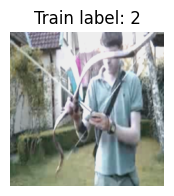

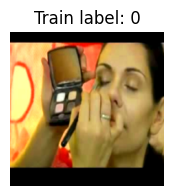

[Train] Batch 3, labels: [2, 0, 0, 0]


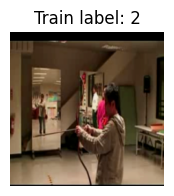

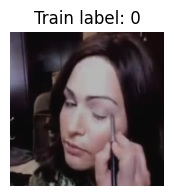

[Train] Batch 4, labels: [2, 1, 3, 3]


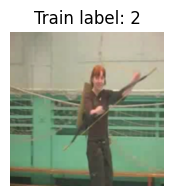

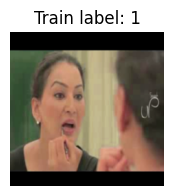

[Train] Batch 5, labels: [2, 2, 3, 0]


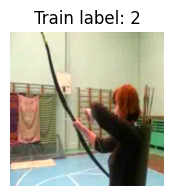

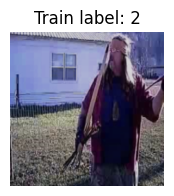

[Train] Batch 6, labels: [1, 1, 2, 4]


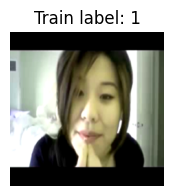

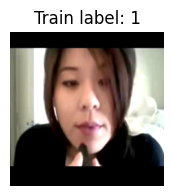

[Train] Batch 7, labels: [2, 3, 4, 4]


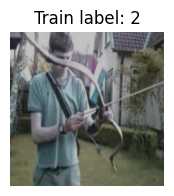

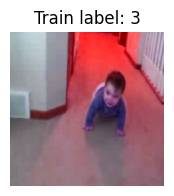

[Train] Batch 8, labels: [2, 0, 4, 3]


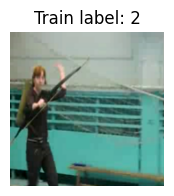

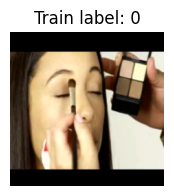

[Train] Batch 9, labels: [4, 1, 0, 0]


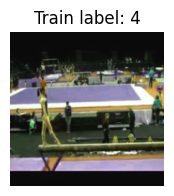

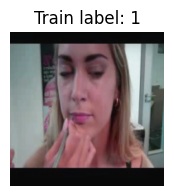

[Train] Batch 10, labels: [3, 4, 1, 2]


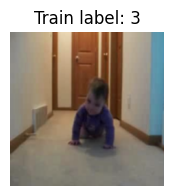

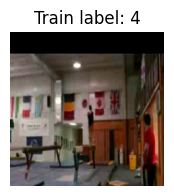

[Train] Batch 11, labels: [2, 0, 3, 0]


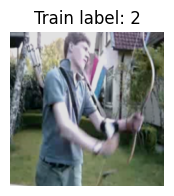

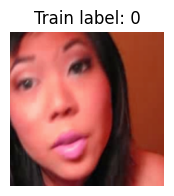

[Train] Batch 12, labels: [1, 2, 3, 1]


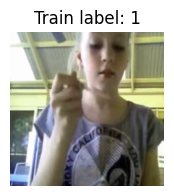

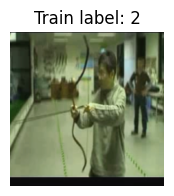

[Train] Batch 13, labels: [1, 2, 0, 2]


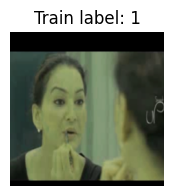

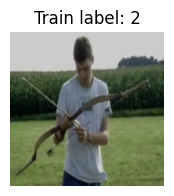

[Train] Batch 14, labels: [2, 4, 2, 1]


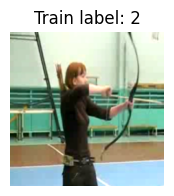

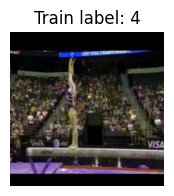

[Train] Batch 15, labels: [4, 4, 3, 3]


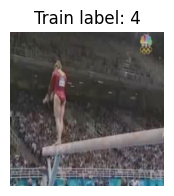

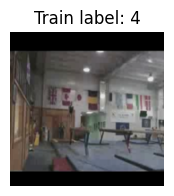

[Train] Batch 16, labels: [4, 1, 1, 4]


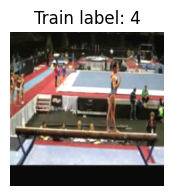

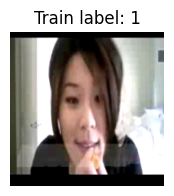

[Train] Batch 17, labels: [0, 1, 2, 4]


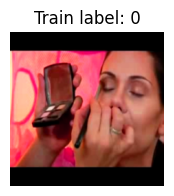

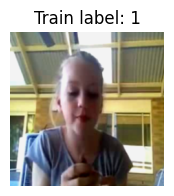

[Train] Batch 18, labels: [4, 1, 2, 3]


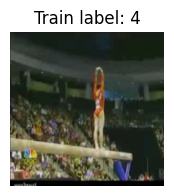

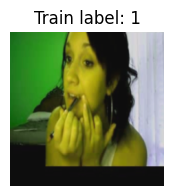

[Train] Batch 19, labels: [2, 4, 3, 3]


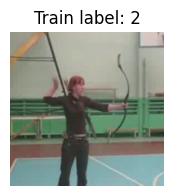

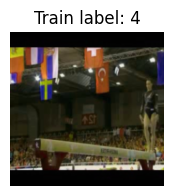

Train Loss: 0.0968, Acc: 1.000
[Val]   Batch 0, labels: [3, 1, 1, 4]


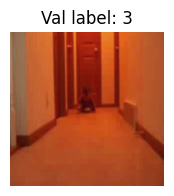

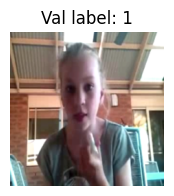

[Val]   Batch 1, labels: [4, 0, 2, 3]


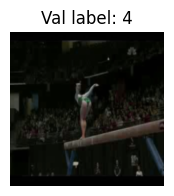

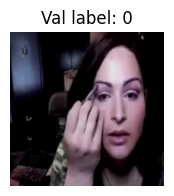

[Val]   Batch 2, labels: [0, 3, 4, 0]


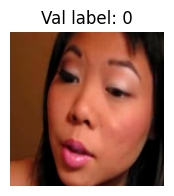

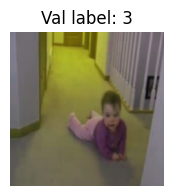

[Val]   Batch 3, labels: [0, 1, 1, 1]


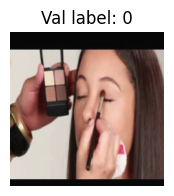

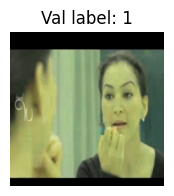

[Val]   Batch 4, labels: [4, 0, 0, 4]


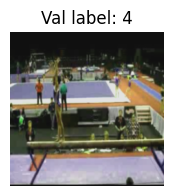

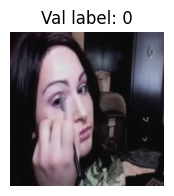

Val Loss:   0.0420, Acc: 1.000

=== Epoch 6/10 ===
[Train] Batch 0, labels: [0, 3, 3, 4]


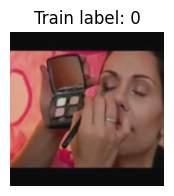

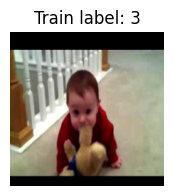

[Train] Batch 1, labels: [3, 4, 0, 3]


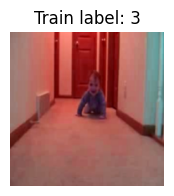

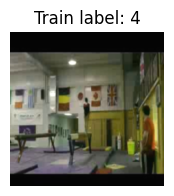

[Train] Batch 2, labels: [2, 1, 1, 3]


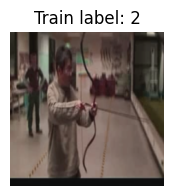

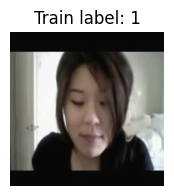

[Train] Batch 3, labels: [4, 2, 4, 1]


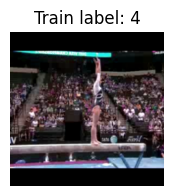

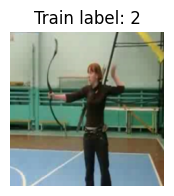

[Train] Batch 4, labels: [4, 4, 0, 1]


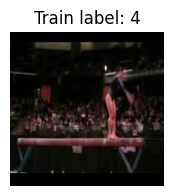

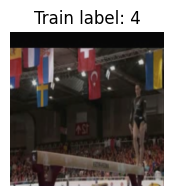

[Train] Batch 5, labels: [2, 1, 1, 0]


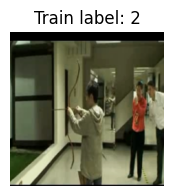

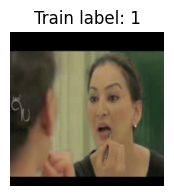

[Train] Batch 6, labels: [1, 2, 1, 2]


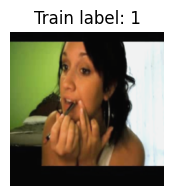

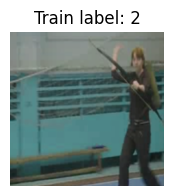

[Train] Batch 7, labels: [2, 3, 0, 0]


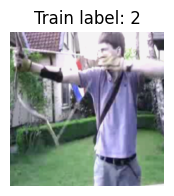

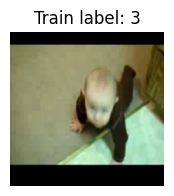

[Train] Batch 8, labels: [4, 3, 2, 3]


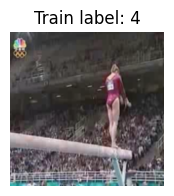

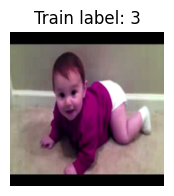

[Train] Batch 9, labels: [2, 2, 1, 0]


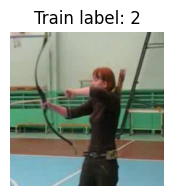

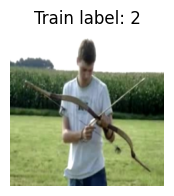

[Train] Batch 10, labels: [0, 4, 0, 4]


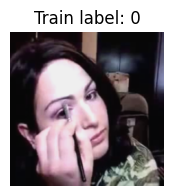

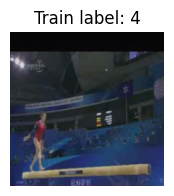

[Train] Batch 11, labels: [2, 0, 1, 3]


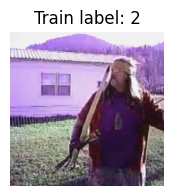

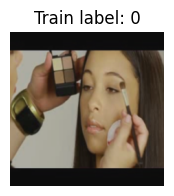

[Train] Batch 12, labels: [2, 3, 4, 1]


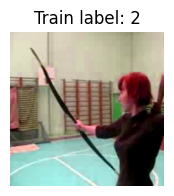

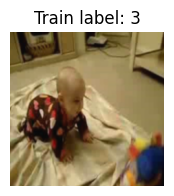

[Train] Batch 13, labels: [2, 2, 3, 2]


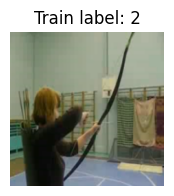

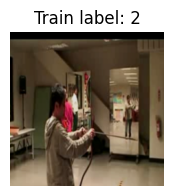

[Train] Batch 14, labels: [3, 0, 4, 1]


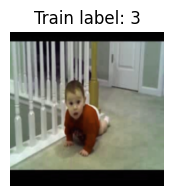

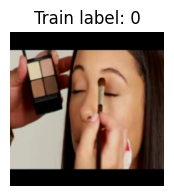

[Train] Batch 15, labels: [1, 3, 2, 0]


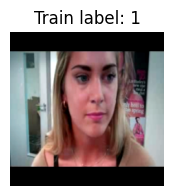

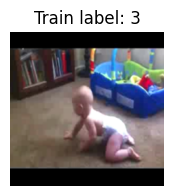

[Train] Batch 16, labels: [4, 2, 4, 3]


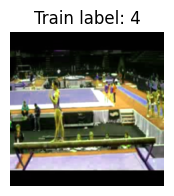

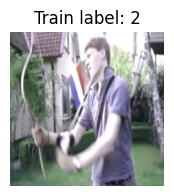

[Train] Batch 17, labels: [3, 2, 3, 0]


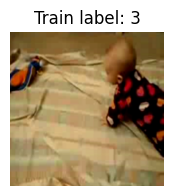

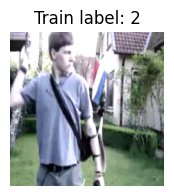

[Train] Batch 18, labels: [1, 2, 1, 3]


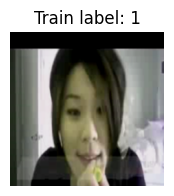

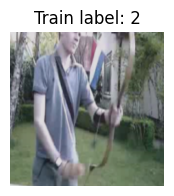

[Train] Batch 19, labels: [4, 0, 2, 4]


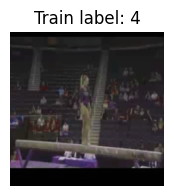

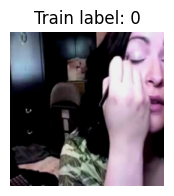

Train Loss: 0.0737, Acc: 0.988
[Val]   Batch 0, labels: [3, 1, 1, 4]


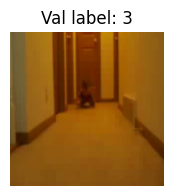

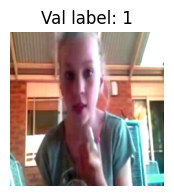

[Val]   Batch 1, labels: [4, 0, 2, 3]


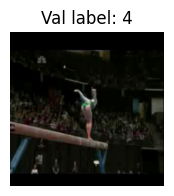

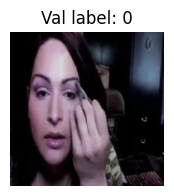

[Val]   Batch 2, labels: [0, 3, 4, 0]


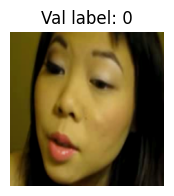

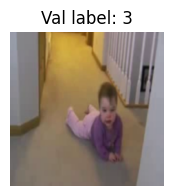

[Val]   Batch 3, labels: [0, 1, 1, 1]


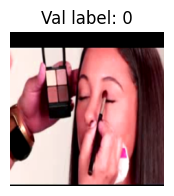

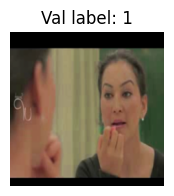

[Val]   Batch 4, labels: [4, 0, 0, 4]


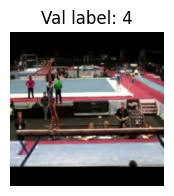

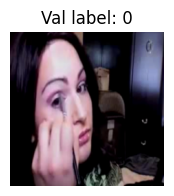

Val Loss:   0.0335, Acc: 1.000

=== Epoch 7/10 ===
[Train] Batch 0, labels: [4, 2, 4, 4]


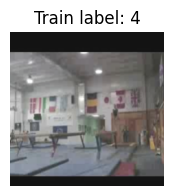

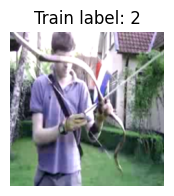

[Train] Batch 1, labels: [4, 1, 3, 2]


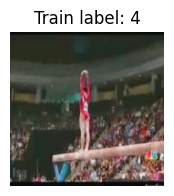

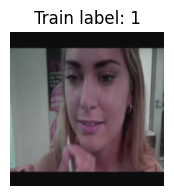

[Train] Batch 2, labels: [3, 2, 0, 4]


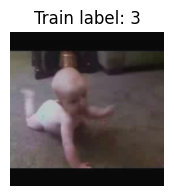

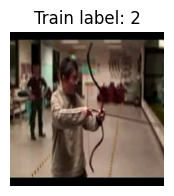

[Train] Batch 3, labels: [3, 0, 0, 3]


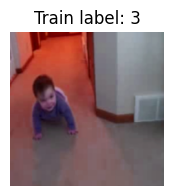

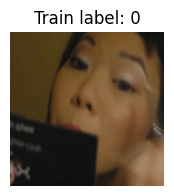

[Train] Batch 4, labels: [4, 3, 4, 1]


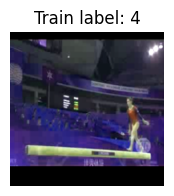

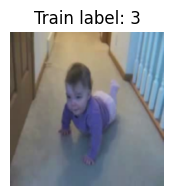

[Train] Batch 5, labels: [2, 4, 2, 2]


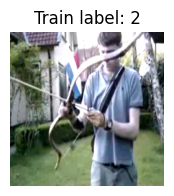

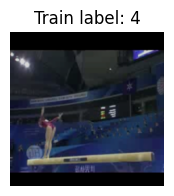

[Train] Batch 6, labels: [4, 2, 3, 1]


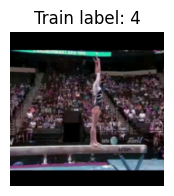

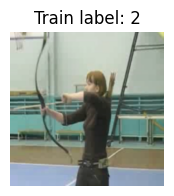

[Train] Batch 7, labels: [0, 1, 1, 0]


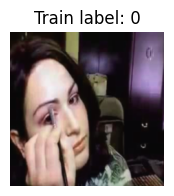

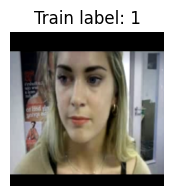

[Train] Batch 8, labels: [3, 1, 2, 1]


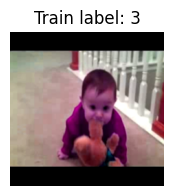

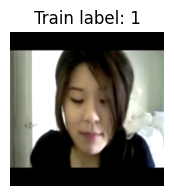

[Train] Batch 9, labels: [0, 1, 3, 1]


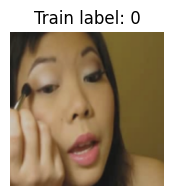

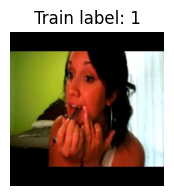

[Train] Batch 10, labels: [2, 1, 4, 2]


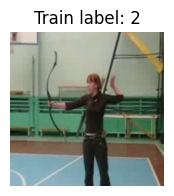

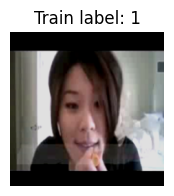

[Train] Batch 11, labels: [0, 0, 3, 4]


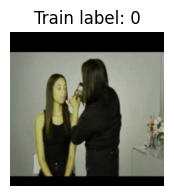

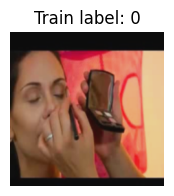

[Train] Batch 12, labels: [0, 2, 0, 0]


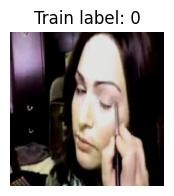

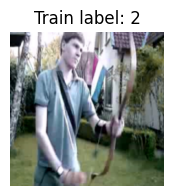

[Train] Batch 13, labels: [3, 2, 3, 1]


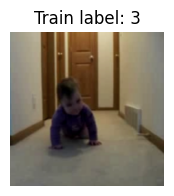

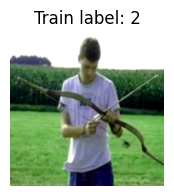

[Train] Batch 14, labels: [3, 1, 2, 2]


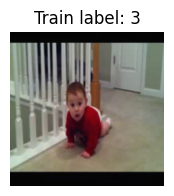

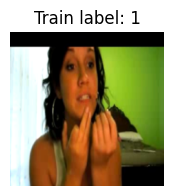

[Train] Batch 15, labels: [4, 1, 0, 3]


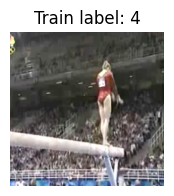

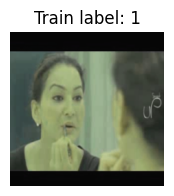

[Train] Batch 16, labels: [1, 3, 0, 2]


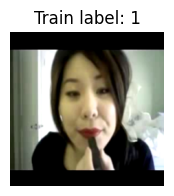

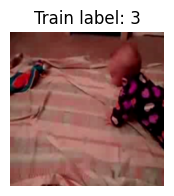

[Train] Batch 17, labels: [1, 2, 3, 4]


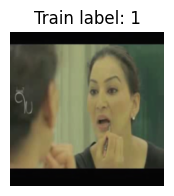

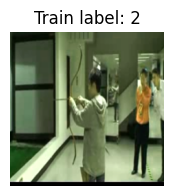

[Train] Batch 18, labels: [2, 2, 3, 4]


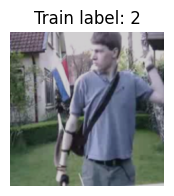

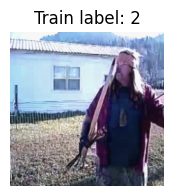

[Train] Batch 19, labels: [4, 3, 2, 0]


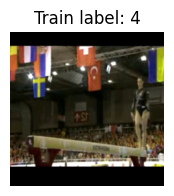

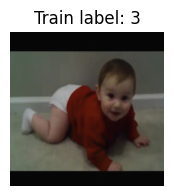

Train Loss: 0.0576, Acc: 1.000
[Val]   Batch 0, labels: [3, 1, 1, 4]


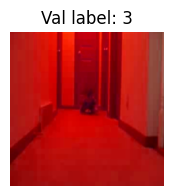

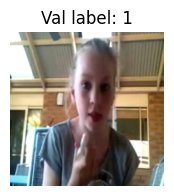

[Val]   Batch 1, labels: [4, 0, 2, 3]


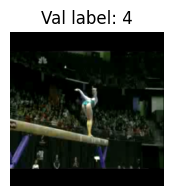

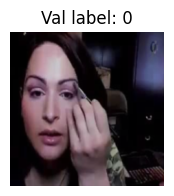

[Val]   Batch 2, labels: [0, 3, 4, 0]


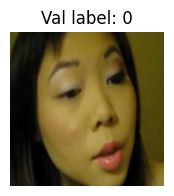

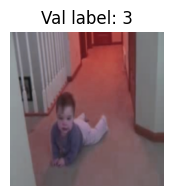

[Val]   Batch 3, labels: [0, 1, 1, 1]


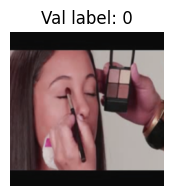

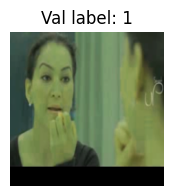

[Val]   Batch 4, labels: [4, 0, 0, 4]


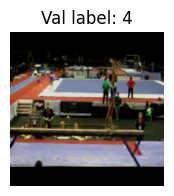

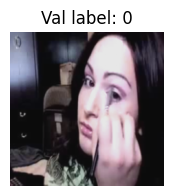

Val Loss:   0.0328, Acc: 1.000

=== Epoch 8/10 ===
[Train] Batch 0, labels: [2, 4, 2, 2]


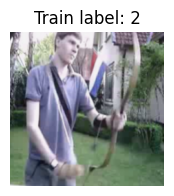

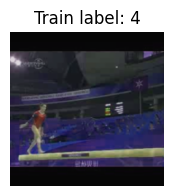

[Train] Batch 1, labels: [2, 1, 4, 3]


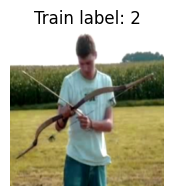

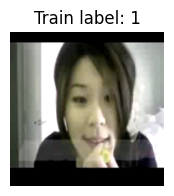

[Train] Batch 2, labels: [1, 3, 3, 3]


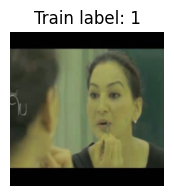

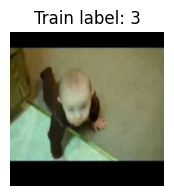

[Train] Batch 3, labels: [2, 1, 2, 4]


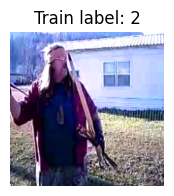

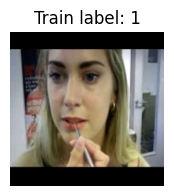

[Train] Batch 4, labels: [0, 1, 3, 3]


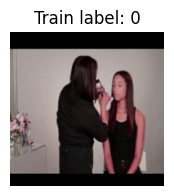

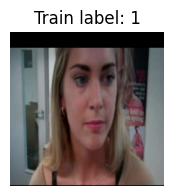

[Train] Batch 5, labels: [1, 4, 0, 2]


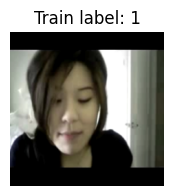

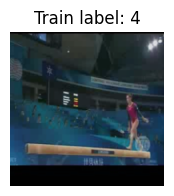

[Train] Batch 6, labels: [4, 3, 1, 4]


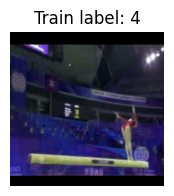

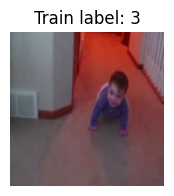

[Train] Batch 7, labels: [0, 3, 2, 3]


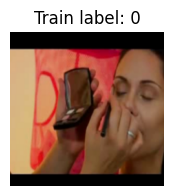

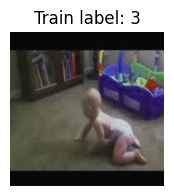

[Train] Batch 8, labels: [3, 0, 1, 0]


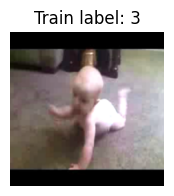

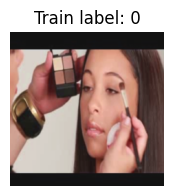

[Train] Batch 9, labels: [3, 3, 4, 3]


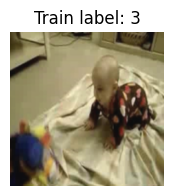

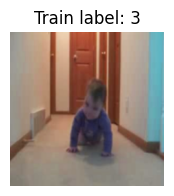

[Train] Batch 10, labels: [2, 2, 2, 1]


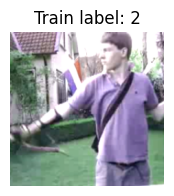

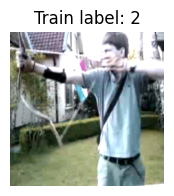

[Train] Batch 11, labels: [0, 1, 0, 4]


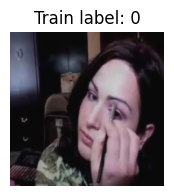

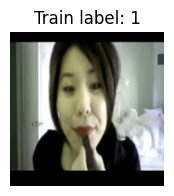

[Train] Batch 12, labels: [1, 3, 0, 1]


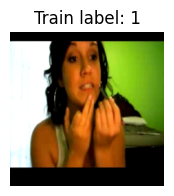

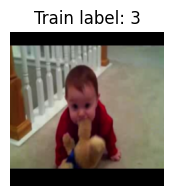

[Train] Batch 13, labels: [1, 2, 0, 2]


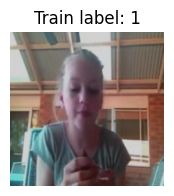

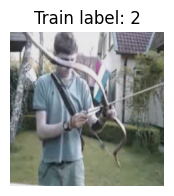

[Train] Batch 14, labels: [4, 4, 2, 2]


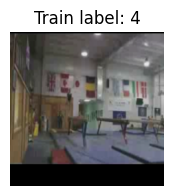

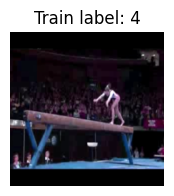

[Train] Batch 15, labels: [0, 2, 2, 4]


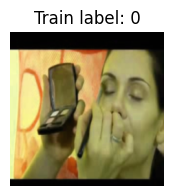

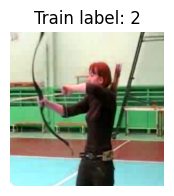

[Train] Batch 16, labels: [1, 3, 3, 0]


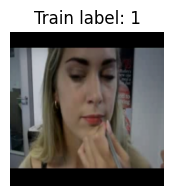

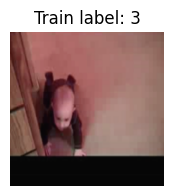

[Train] Batch 17, labels: [4, 0, 4, 0]


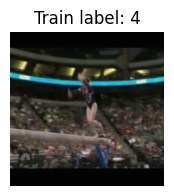

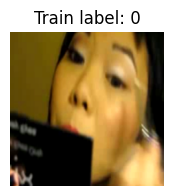

[Train] Batch 18, labels: [3, 4, 2, 2]


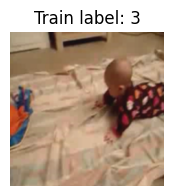

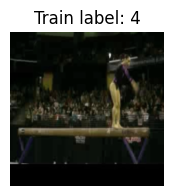

[Train] Batch 19, labels: [1, 4, 1, 0]


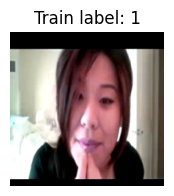

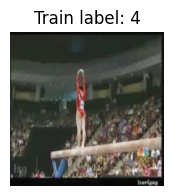

Train Loss: 0.1402, Acc: 0.950
[Val]   Batch 0, labels: [3, 1, 1, 4]


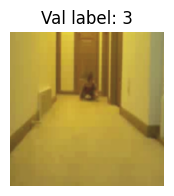

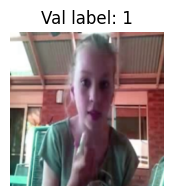

[Val]   Batch 1, labels: [4, 0, 2, 3]


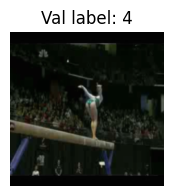

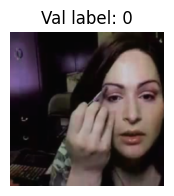

[Val]   Batch 2, labels: [0, 3, 4, 0]


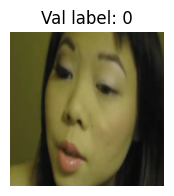

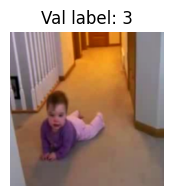

[Val]   Batch 3, labels: [0, 1, 1, 1]


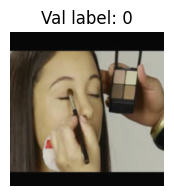

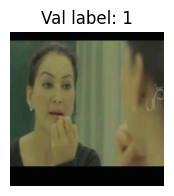

[Val]   Batch 4, labels: [4, 0, 0, 4]


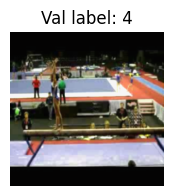

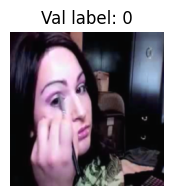

Val Loss:   0.0356, Acc: 1.000

=== Epoch 9/10 ===
[Train] Batch 0, labels: [3, 2, 2, 3]


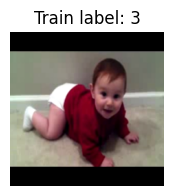

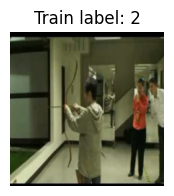

[Train] Batch 1, labels: [0, 3, 3, 1]


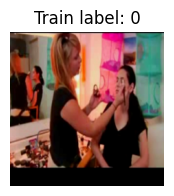

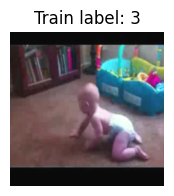

[Train] Batch 2, labels: [3, 2, 3, 0]


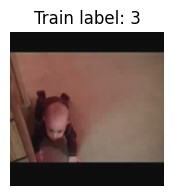

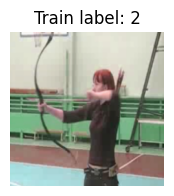

[Train] Batch 3, labels: [4, 2, 3, 4]


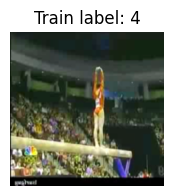

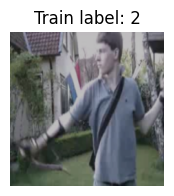

[Train] Batch 4, labels: [0, 4, 3, 2]


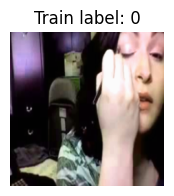

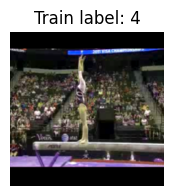

[Train] Batch 5, labels: [4, 1, 2, 1]


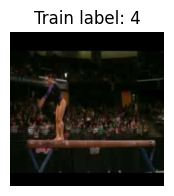

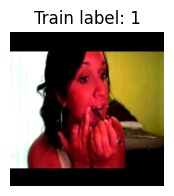

[Train] Batch 6, labels: [3, 4, 3, 0]


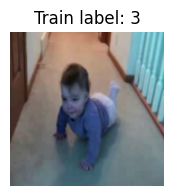

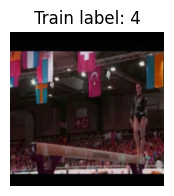

[Train] Batch 7, labels: [1, 3, 0, 2]


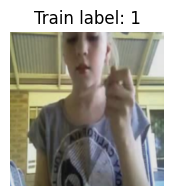

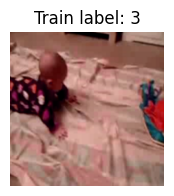

[Train] Batch 8, labels: [1, 4, 4, 4]


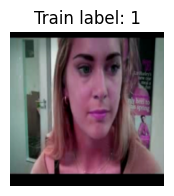

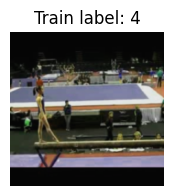

[Train] Batch 9, labels: [2, 4, 0, 4]


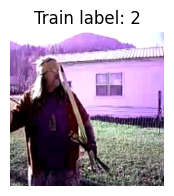

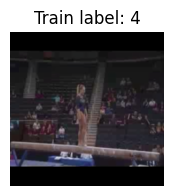

[Train] Batch 10, labels: [2, 1, 0, 1]


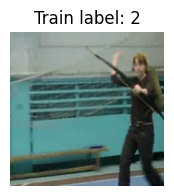

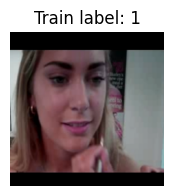

[Train] Batch 11, labels: [2, 0, 2, 2]


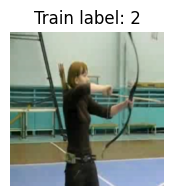

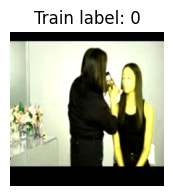

[Train] Batch 12, labels: [0, 1, 2, 3]


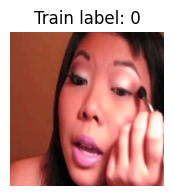

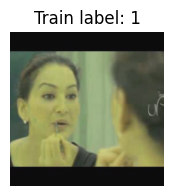

[Train] Batch 13, labels: [3, 0, 3, 1]


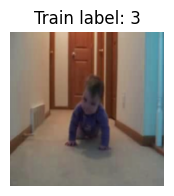

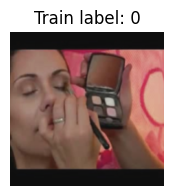

[Train] Batch 14, labels: [4, 3, 1, 4]


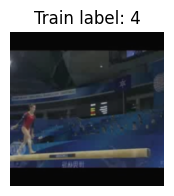

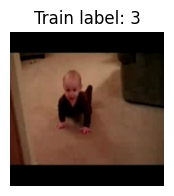

[Train] Batch 15, labels: [1, 1, 2, 1]


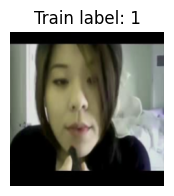

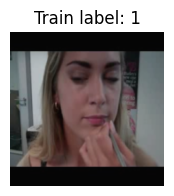

[Train] Batch 16, labels: [1, 4, 3, 2]


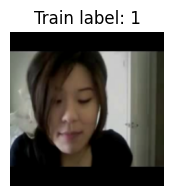

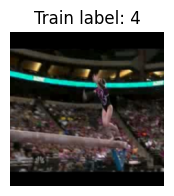

[Train] Batch 17, labels: [1, 0, 2, 0]


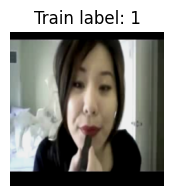

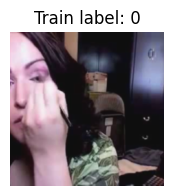

[Train] Batch 18, labels: [4, 2, 3, 0]


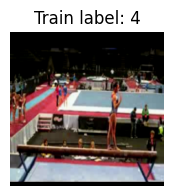

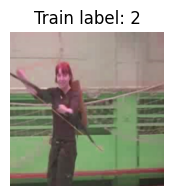

[Train] Batch 19, labels: [0, 2, 2, 4]


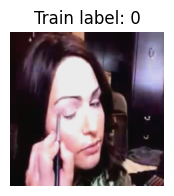

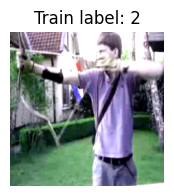

Train Loss: 0.0808, Acc: 0.988
[Val]   Batch 0, labels: [3, 1, 1, 4]


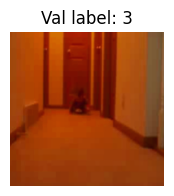

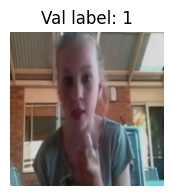

[Val]   Batch 1, labels: [4, 0, 2, 3]


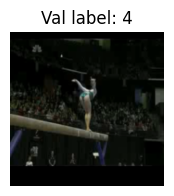

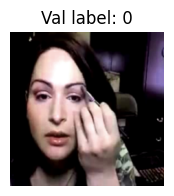

[Val]   Batch 2, labels: [0, 3, 4, 0]


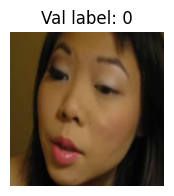

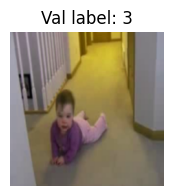

[Val]   Batch 3, labels: [0, 1, 1, 1]


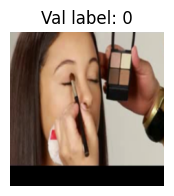

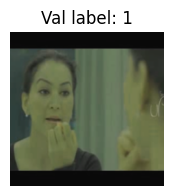

[Val]   Batch 4, labels: [4, 0, 0, 4]


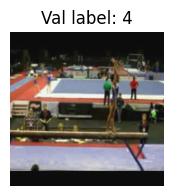

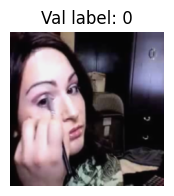

Val Loss:   0.0384, Acc: 1.000

=== Epoch 10/10 ===
[Train] Batch 0, labels: [1, 2, 2, 1]


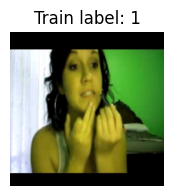

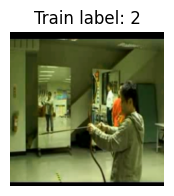

[Train] Batch 1, labels: [1, 4, 2, 3]


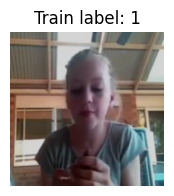

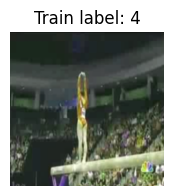

[Train] Batch 2, labels: [3, 2, 3, 4]


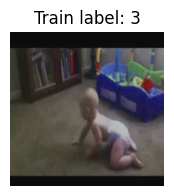

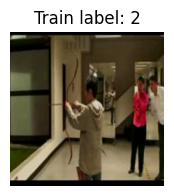

[Train] Batch 3, labels: [1, 0, 0, 1]


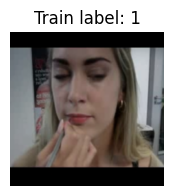

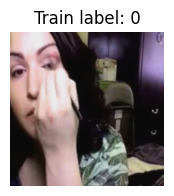

[Train] Batch 4, labels: [4, 3, 0, 0]


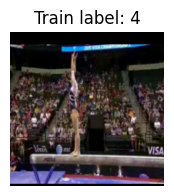

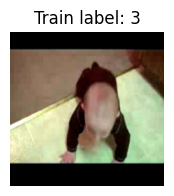

[Train] Batch 5, labels: [2, 2, 2, 2]


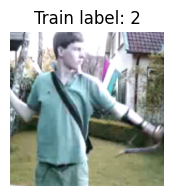

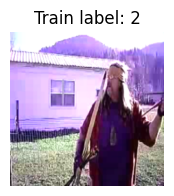

[Train] Batch 6, labels: [1, 1, 2, 0]


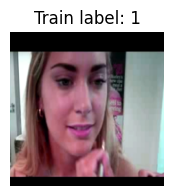

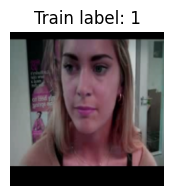

[Train] Batch 7, labels: [3, 4, 3, 4]


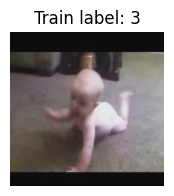

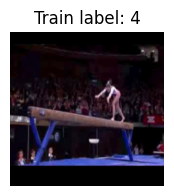

[Train] Batch 8, labels: [4, 1, 0, 0]


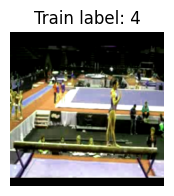

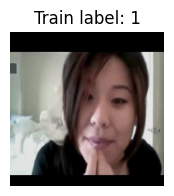

[Train] Batch 9, labels: [4, 4, 3, 3]


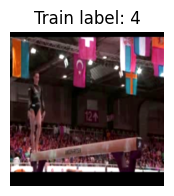

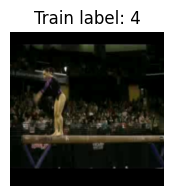

[Train] Batch 10, labels: [1, 1, 0, 4]


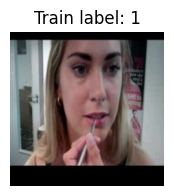

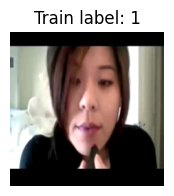

[Train] Batch 11, labels: [2, 2, 4, 2]


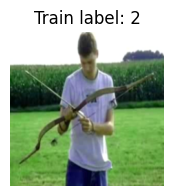

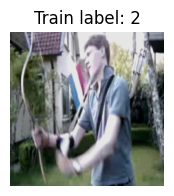

[Train] Batch 12, labels: [2, 3, 2, 1]


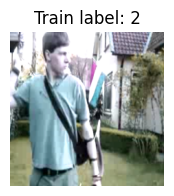

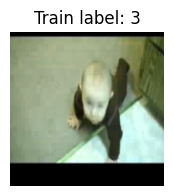

[Train] Batch 13, labels: [4, 3, 0, 2]


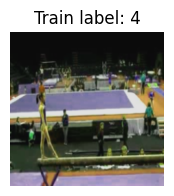

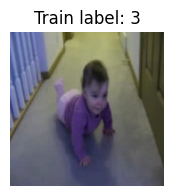

[Train] Batch 14, labels: [1, 3, 3, 3]


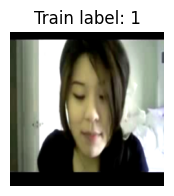

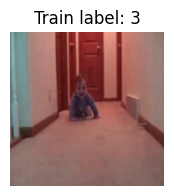

[Train] Batch 15, labels: [0, 1, 4, 2]


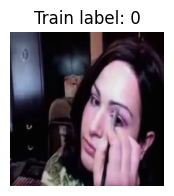

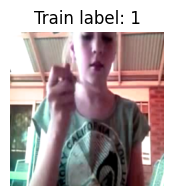

[Train] Batch 16, labels: [0, 1, 3, 0]


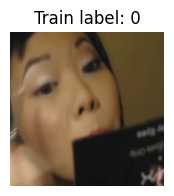

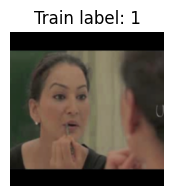

[Train] Batch 17, labels: [2, 0, 3, 4]


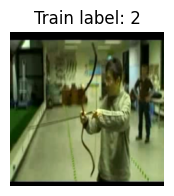

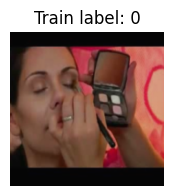

[Train] Batch 18, labels: [2, 4, 1, 2]


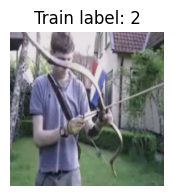

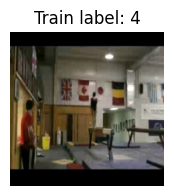

[Train] Batch 19, labels: [3, 3, 0, 4]


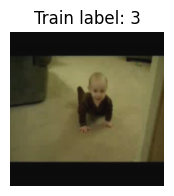

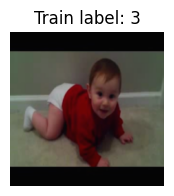

Train Loss: 0.1418, Acc: 0.975
[Val]   Batch 0, labels: [3, 1, 1, 4]


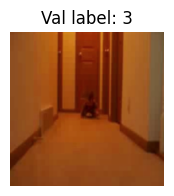

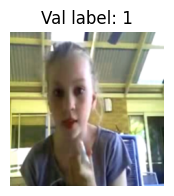

[Val]   Batch 1, labels: [4, 0, 2, 3]


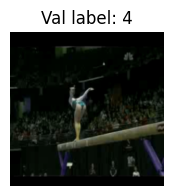

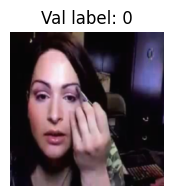

[Val]   Batch 2, labels: [0, 3, 4, 0]


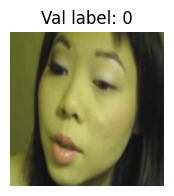

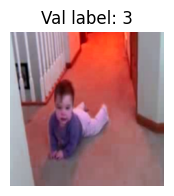

[Val]   Batch 3, labels: [0, 1, 1, 1]


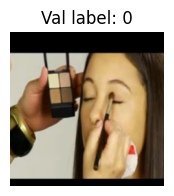

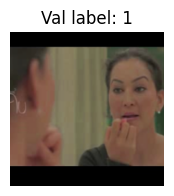

[Val]   Batch 4, labels: [4, 0, 0, 4]


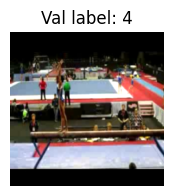

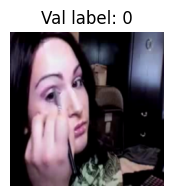

Val Loss:   0.1212, Acc: 0.950
✅ Training complete, model saved.


In [ ]:
import os
import random
import torch
import matplotlib.pyplot as plt
from torch import nn
from torch.utils.data import DataLoader
from torchvision import transforms, models
from PIL import Image

# 1) Hyperparameters & Paths
NUM_CLASSES  = 5
SEQ_LENGTH   = 50
BATCH_SIZE   = 4
NUM_EPOCHS   = 10
LR           = 1e-4

FRAME_DIR    = '/content/UCF101_frames'
TRAIN_SPLIT  = '/content/drive/MyDrive/train_small.txt'
TEST_SPLIT   = '/content/drive/MyDrive/test_small.txt'
CHECKPOINT   = '/content/drive/MyDrive/best_model_no_earlystop.pth'
DEVICE       = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Normalization tensors (for de-normalizing when plotting)
mean = torch.tensor([0.485, 0.456, 0.406])
std  = torch.tensor([0.229, 0.224, 0.225])

# 0) Utility to show first frame of a tensor sequence
def show_first_frame(seq_tensor, label, tag="Train"):
    """
    seq_tensor: (T, C, H, W)
    """
    img = seq_tensor[0] * std[:, None, None] + mean[:, None, None]
    img = torch.clamp(img, 0, 1).permute(1,2,0).cpu().numpy()
    plt.figure(figsize=(2,2))
    plt.imshow(img)
    plt.title(f"{tag} label: {label}")
    plt.axis('off')
    plt.show()

# 2) Dataset Definition with random-frame sampling
class VideoFrameDataset(torch.utils.data.Dataset):
    def __init__(self, root_dir, split_file, transform=None, seq_length=SEQ_LENGTH):
        self.root_dir   = root_dir
        self.transform  = transform
        self.seq_length = seq_length
        self.samples    = []
        with open(split_file) as f:
            for ln in f:
                path, lbl = ln.strip().split()
                action, vid = path.split('/',1)
                folder = os.path.join(root_dir, action, vid.replace('.avi',''))
                if os.path.isdir(folder):
                    self.samples.append((folder, int(lbl)-1))

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        folder, label = self.samples[idx]
        # Randomly sample seq_length frames (or all if fewer)
        all_frames = sorted(os.listdir(folder))
        if len(all_frames) >= self.seq_length:
            frames = random.sample(all_frames, self.seq_length)
        else:
            frames = all_frames[:]
        frames.sort()  # ensure temporal order
        # Load & transform
        seq = []
        for fn in frames:
            img = Image.open(os.path.join(folder, fn)).convert('RGB')
            if self.transform:
                img = self.transform(img)
            seq.append(img)
        return torch.stack(seq), label

# 3) Data Augmentation + Normalization
frame_transform = transforms.Compose([
    transforms.Resize((256,256)),
    transforms.RandomResizedCrop(224, scale=(0.8,1.0)),
    transforms.RandomHorizontalFlip(),
    transforms.ColorJitter(0.2,0.2,0.2,0.1),
    transforms.ToTensor(),
    transforms.Normalize(mean.tolist(), std.tolist()),
])

# 4) Instantiate datasets & check for video‐level overlap
train_ds = VideoFrameDataset(FRAME_DIR, TRAIN_SPLIT, transform=frame_transform)
test_ds  = VideoFrameDataset(FRAME_DIR, TEST_SPLIT,  transform=frame_transform)
print(f"Train samples: {len(train_ds)}, Test samples: {len(test_ds)}")

train_paths = {folder for folder,_ in train_ds.samples}
test_paths  = {folder for folder,_ in test_ds.samples}
overlap     = train_paths & test_paths
print("Video‐level overlap (should be empty):", overlap)

# 5) DataLoaders
train_loader = DataLoader(
    train_ds, batch_size=BATCH_SIZE, shuffle=True,
    num_workers=0, drop_last=True
)
test_loader = DataLoader(
    test_ds,  batch_size=BATCH_SIZE, shuffle=False,
    num_workers=0
)

# 6) Model Definition
class CNN_LSTM(nn.Module):
    def __init__(self, hidden_size=256, num_classes=NUM_CLASSES):
        super().__init__()
        resnet = models.resnet18(pretrained=True)
        self.cnn  = nn.Sequential(*list(resnet.children())[:-1])
        feat_dim  = resnet.fc.in_features
        self.lstm = nn.LSTM(feat_dim, hidden_size, batch_first=True)
        self.fc   = nn.Linear(hidden_size, num_classes)

    def forward(self, x):
        B, T, C, H, W = x.size()
        x = x.view(B*T, C, H, W)
        feats = self.cnn(x).view(B, T, -1)
        out, _ = self.lstm(feats)
        return self.fc(out[:, -1, :])

model     = CNN_LSTM().to(DEVICE)
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=LR)

# 7) Training & Validation Loop (no early stopping)
for epoch in range(1, NUM_EPOCHS+1):
    print(f"\n=== Epoch {epoch}/{NUM_EPOCHS} ===")
    # — Train —
    model.train()
    total_loss, total_correct = 0.0, 0
    for b_idx, (seqs, labels) in enumerate(train_loader):
        print(f"[Train] Batch {b_idx}, labels: {labels.tolist()}")
        # Show first frames for the first two samples
        for i in range(min(2, seqs.size(0))):
            show_first_frame(seqs[i], labels[i].item(), tag="Train")
        seqs, labels = seqs.to(DEVICE), labels.to(DEVICE)
        preds = model(seqs)
        loss  = criterion(preds, labels)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        total_loss    += loss.item() * seqs.size(0)
        total_correct += (preds.argmax(1)==labels).sum().item()
    print(f"Train Loss: {total_loss/len(train_ds):.4f}, Acc: {total_correct/len(train_ds):.3f}")

    # — Validate —
    model.eval()
    val_loss, val_correct = 0.0, 0
    with torch.no_grad():
        for b_idx, (seqs, labels) in enumerate(test_loader):
            print(f"[Val]   Batch {b_idx}, labels: {labels.tolist()}")
            for i in range(min(2, seqs.size(0))):
                show_first_frame(seqs[i], labels[i].item(), tag="Val")
            seqs, labels = seqs.to(DEVICE), labels.to(DEVICE)
            preds = model(seqs)
            loss  = criterion(preds, labels)
            val_loss    += loss.item() * seqs.size(0)
            val_correct += (preds.argmax(1)==labels).sum().item()
    print(f"Val Loss:   {val_loss/len(test_ds):.4f}, Acc: {val_correct/len(test_ds):.3f}")

# 8) Save final model
torch.save(model.state_dict(), CHECKPOINT)
print("✅ Training complete, model saved.")
